### Dog Breed DCGAN Pytorch Batch64 Epoch50

In [1]:
from __future__ import print_function
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
import pandas
import lmdb
from sklearn.model_selection import train_test_split

np.random.seed(2)

In [2]:
cd "/home/pinkmonkey/Documents/Dogs_Breeds"

/home/pinkmonkey/Documents/Dogs_Breeds


In [3]:
pwd

'/home/pinkmonkey/Documents/Dogs_Breeds'

In [28]:
dataroot = "/home/pinkmonkey/Documents/Dogs_Breeds/Images"
# Number of workers for dataloader
workers = 1

# Batch size during training
batch_size = 8

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 50

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

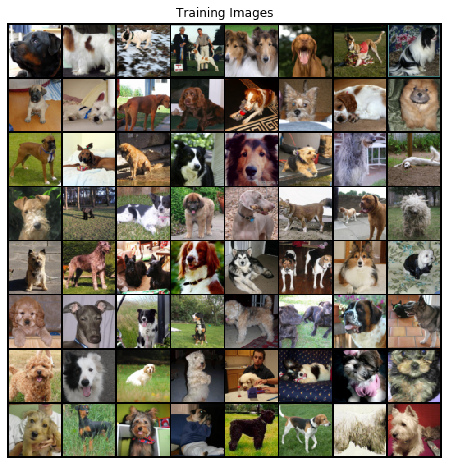

In [29]:
# We can use an image folder dataset the way we have it setup.
# Create the dataset
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=64,
                                         shuffle=True, num_workers=1)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))
plt.savefig('Training Images');

In [30]:
# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [31]:
# Generator Code

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)

In [32]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [33]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [34]:
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [35]:
torch.cuda.is_available()

True

In [36]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1
fake_label = 0

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [37]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Add the gradients from the all-real and all-fake batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...
[0/50][0/322]	Loss_D: 1.3382	Loss_G: 6.4191	D(x): 0.5785	D(G(z)): 0.4525 / 0.0022
[0/50][50/322]	Loss_D: 0.6381	Loss_G: 19.8790	D(x): 0.7267	D(G(z)): 0.0000 / 0.0000
[0/50][100/322]	Loss_D: 0.3239	Loss_G: 5.2387	D(x): 0.8155	D(G(z)): 0.0666 / 0.0195
[0/50][150/322]	Loss_D: 1.4940	Loss_G: 7.3978	D(x): 0.8923	D(G(z)): 0.6629 / 0.0014
[0/50][200/322]	Loss_D: 1.3538	Loss_G: 9.6570	D(x): 0.9530	D(G(z)): 0.5744 / 0.0002
[0/50][250/322]	Loss_D: 0.4450	Loss_G: 8.6376	D(x): 0.7914	D(G(z)): 0.0022 / 0.0003
[0/50][300/322]	Loss_D: 0.1423	Loss_G: 4.7675	D(x): 0.9236	D(G(z)): 0.0452 / 0.0176
[1/50][0/322]	Loss_D: 0.4311	Loss_G: 6.9668	D(x): 0.9396	D(G(z)): 0.2744 / 0.0015
[1/50][50/322]	Loss_D: 0.1233	Loss_G: 4.5463	D(x): 0.9119	D(G(z)): 0.0196 / 0.0206
[1/50][100/322]	Loss_D: 0.2336	Loss_G: 3.3129	D(x): 0.9182	D(G(z)): 0.0972 / 0.0796
[1/50][150/322]	Loss_D: 0.4713	Loss_G: 3.1692	D(x): 0.7536	D(G(z)): 0.1212 / 0.0707
[1/50][200/322]	Loss_D: 0.3000	Loss_G: 4.4512	D(x): 0.8

[14/50][0/322]	Loss_D: 1.1384	Loss_G: 0.5923	D(x): 0.4168	D(G(z)): 0.0865 / 0.5922
[14/50][50/322]	Loss_D: 0.4952	Loss_G: 4.2988	D(x): 0.9190	D(G(z)): 0.3093 / 0.0196
[14/50][100/322]	Loss_D: 0.3364	Loss_G: 3.8515	D(x): 0.8482	D(G(z)): 0.1293 / 0.0322
[14/50][150/322]	Loss_D: 0.8383	Loss_G: 2.9020	D(x): 0.7439	D(G(z)): 0.3571 / 0.0717
[14/50][200/322]	Loss_D: 0.5227	Loss_G: 2.7444	D(x): 0.7410	D(G(z)): 0.1524 / 0.0930
[14/50][250/322]	Loss_D: 0.7217	Loss_G: 0.8574	D(x): 0.5497	D(G(z)): 0.0239 / 0.4674
[14/50][300/322]	Loss_D: 0.5963	Loss_G: 2.0735	D(x): 0.6238	D(G(z)): 0.0527 / 0.1800
[15/50][0/322]	Loss_D: 0.4456	Loss_G: 3.9284	D(x): 0.9421	D(G(z)): 0.2710 / 0.0275
[15/50][50/322]	Loss_D: 0.6288	Loss_G: 3.0522	D(x): 0.7848	D(G(z)): 0.2640 / 0.0726
[15/50][100/322]	Loss_D: 0.4791	Loss_G: 3.0353	D(x): 0.8149	D(G(z)): 0.1931 / 0.0705
[15/50][150/322]	Loss_D: 1.2208	Loss_G: 5.2794	D(x): 0.9317	D(G(z)): 0.6071 / 0.0092
[15/50][200/322]	Loss_D: 0.6850	Loss_G: 1.7321	D(x): 0.6142	D(G(z)): 0.

[27/50][300/322]	Loss_D: 0.7482	Loss_G: 4.0195	D(x): 0.8459	D(G(z)): 0.3621 / 0.0263
[28/50][0/322]	Loss_D: 0.4111	Loss_G: 4.4156	D(x): 0.9428	D(G(z)): 0.2605 / 0.0181
[28/50][50/322]	Loss_D: 0.4460	Loss_G: 2.9380	D(x): 0.8961	D(G(z)): 0.2547 / 0.0718
[28/50][100/322]	Loss_D: 0.5924	Loss_G: 2.0463	D(x): 0.6157	D(G(z)): 0.0426 / 0.2009
[28/50][150/322]	Loss_D: 1.6139	Loss_G: 6.3048	D(x): 0.9854	D(G(z)): 0.7024 / 0.0040
[28/50][200/322]	Loss_D: 0.3566	Loss_G: 3.5213	D(x): 0.8390	D(G(z)): 0.1393 / 0.0399
[28/50][250/322]	Loss_D: 0.2747	Loss_G: 2.2060	D(x): 0.9182	D(G(z)): 0.1512 / 0.1444
[28/50][300/322]	Loss_D: 0.4704	Loss_G: 4.1171	D(x): 0.9385	D(G(z)): 0.3026 / 0.0233
[29/50][0/322]	Loss_D: 0.4197	Loss_G: 2.7995	D(x): 0.8080	D(G(z)): 0.1502 / 0.0892
[29/50][50/322]	Loss_D: 0.6718	Loss_G: 1.4032	D(x): 0.6334	D(G(z)): 0.1429 / 0.2898
[29/50][100/322]	Loss_D: 0.7969	Loss_G: 1.2486	D(x): 0.6209	D(G(z)): 0.1736 / 0.3498
[29/50][150/322]	Loss_D: 0.5130	Loss_G: 2.9903	D(x): 0.8522	D(G(z)): 0.

[41/50][250/322]	Loss_D: 0.4749	Loss_G: 2.2276	D(x): 0.6826	D(G(z)): 0.0296 / 0.1642
[41/50][300/322]	Loss_D: 1.1179	Loss_G: 6.5556	D(x): 0.9943	D(G(z)): 0.5605 / 0.0032
[42/50][0/322]	Loss_D: 0.6579	Loss_G: 0.6388	D(x): 0.6032	D(G(z)): 0.0326 / 0.6119
[42/50][50/322]	Loss_D: 0.2044	Loss_G: 3.7434	D(x): 0.9331	D(G(z)): 0.1077 / 0.0375
[42/50][100/322]	Loss_D: 0.2562	Loss_G: 3.7787	D(x): 0.8521	D(G(z)): 0.0573 / 0.0392
[42/50][150/322]	Loss_D: 0.3270	Loss_G: 3.0093	D(x): 0.8774	D(G(z)): 0.1570 / 0.0716
[42/50][200/322]	Loss_D: 0.2421	Loss_G: 4.6181	D(x): 0.9532	D(G(z)): 0.1615 / 0.0145
[42/50][250/322]	Loss_D: 0.1529	Loss_G: 3.7495	D(x): 0.9346	D(G(z)): 0.0759 / 0.0352
[42/50][300/322]	Loss_D: 6.8396	Loss_G: 0.0024	D(x): 0.0035	D(G(z)): 0.0006 / 0.9977
[43/50][0/322]	Loss_D: 1.0683	Loss_G: 4.8291	D(x): 0.7813	D(G(z)): 0.4246 / 0.0155
[43/50][50/322]	Loss_D: 0.3826	Loss_G: 3.1686	D(x): 0.8541	D(G(z)): 0.1653 / 0.0595
[43/50][100/322]	Loss_D: 0.2355	Loss_G: 3.6254	D(x): 0.9039	D(G(z)): 0.

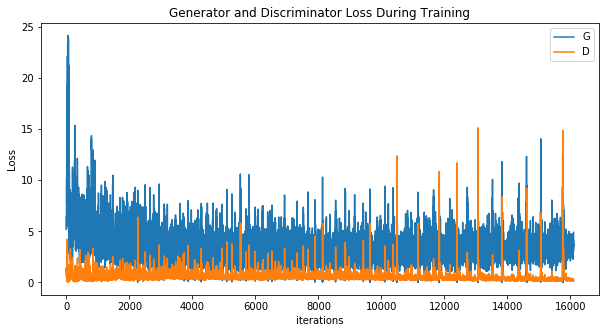

In [45]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.savefig('Loss')
plt.show()

Animation size has reached 21173451 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


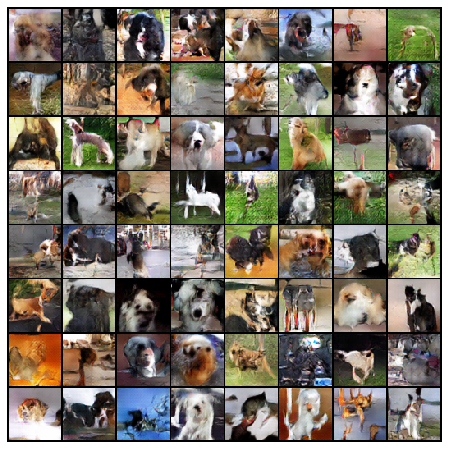

In [46]:
#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

RuntimeError: CUDA error: unspecified launch failure

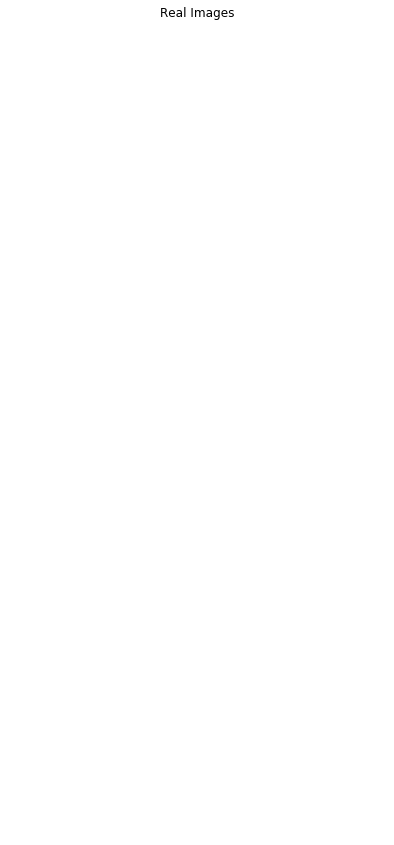

In [50]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.savefig('Fakes')
plt.show()

In [48]:
torch.cuda.is_available()

True

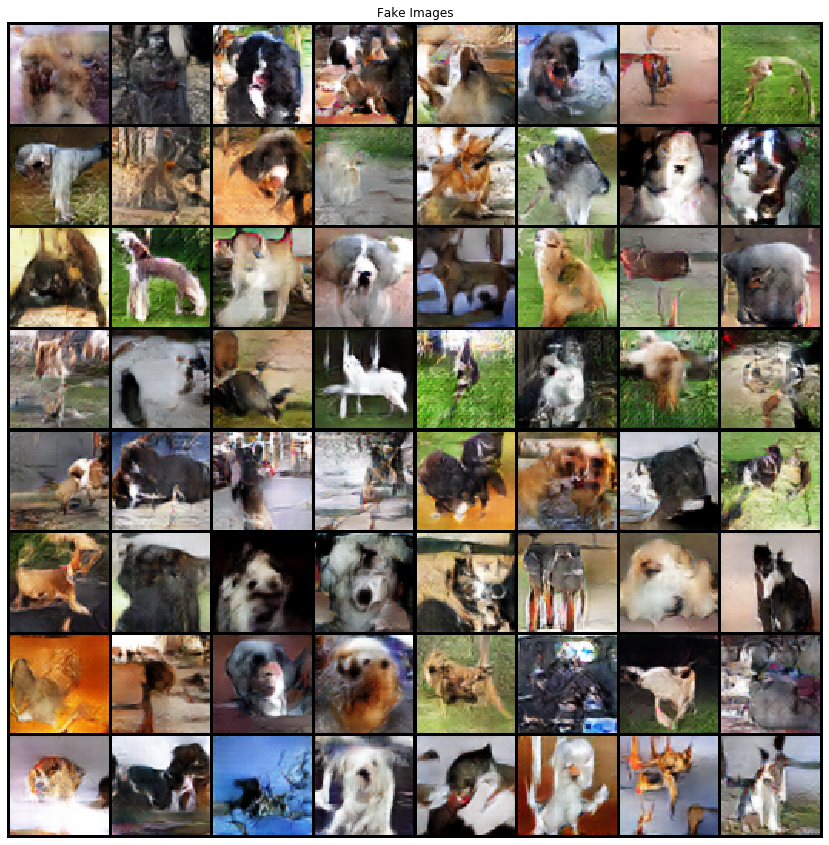

In [49]:
# Plot the fake images from the last epoch
plt.figure(figsize=(15,15))
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

In [15]:
# import tarfile
# tar = tarfile.open("images.tar","r")
# tar.extractall('/home/pinkmonkey/Documents/Dogs_Breeds')

In [16]:
# tarl = tarfile.open("lists.tar","r")
# tarl.extractall('/home/pinkmonkey/Documents/Dogs_Breeds')

In [224]:
l = open("file_list.mat", "r")

In [226]:
import io
with open('file_list.mat', 'rb') as f2:
    mat = f2.read()
    #mat = pickle.load(f2, encoding="latin-1")
    print(mat)
#     wrapper = io.TextIOWrapper(f2, encoding='utf-8', write_through=True)
#     print(wrapper.read())
#     f2.close()

b'MATLAB 5.0 MAT-file, Platform: GLNXA64, Created on: Sun Oct  9 08:29:09 2011                                                \x00\x01IM\x0f\x00\x00\x00\x98\xb3\x01\x00x\x9c\xb4\x98\xcfJ\x031\x10\xc6WP\xd1K\xf1\r<\xb5\x9e\xd4\xcc\x9f\xcc$g_\xc0\xa37\x11\xfc\xd3J\x11A}b_\xc4\xd4\xae"=m\x06\xbf\xa5\xa1\xec\xb2\xf91|\x99\xf9&\xd9\xd90\x0c7\x9f\xa7\xc3a\xfb?jco\xd8^\x07\xe3\xfd\xfd\xf5\xf6\xd9f\x1c\xb7\xf1\xb8Z?\xdc\xaeWo\xef\xe3{\xb3\xcd\xfc6~\xe6\xef\xef\xcc\xdf\xcc;\xfb\xc3=\x19\xef_\x12\xa7\x92\x8d\xd3\xf9\xd5r\xb5\xfc\xb8k\xbf\xcb\xdfg\xb7\x94\x92\xeb\xc5\xf3\xeb\x13\x8cOBP\xbe\xf1t\xfeb\x87\xbf\x98\xc0w\xf9\xc6\xc3\xe2\xafnH}\x884A\xf9,\x05\xcb\xcfX\xbe\x88C\xf9\xea\xd3\xf9\x81\xfc\xa4\xcc\xd0\xfc$\xab\xd8\xfc,\x84]\xdf\xaa\xd3\xf9\x01\xfd9e\xa8\xfe\xdc\x1c\x14\xa9\x0f\x8bL\xf7\xff\x88>\xd2\xa1O\x84\xef\x84\xd5\xdf;\xf23\x12\x7f-\xd0\xf8\x852\xb4?\nc\xf5\x17)\x02\x8d_\r\x1b\x7f5\xe8\xfeJyl\x00(\xbe\xd2t\xfd#\xfcL\xd3\xfbK`}5c\xfdGkG\xff\r\xf0s\x02\xf3s\x87\xffD\xf8V\xa1|#\xc7\xf29A\x

In [17]:
img_dir = "/home/pinkmonkey/Documents/Dogs_Breeds/Images"

In [33]:
cd "/home/pinkmonkey/Documents/Dogs_Breeds/Images/n02085620-Chihuahua"

/home/pinkmonkey/Documents/Dogs_Breeds/Images/n02085620-Chihuahua


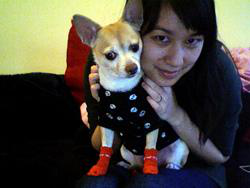

In [34]:
from PIL import Image
im = Image.open("n02085620_7.jpg")
im

In [52]:
from torchvision.transforms import ToTensor, ToPILImage
import numpy as np
tim = ToTensor()(im)
tim.shape

torch.Size([3, 188, 250])

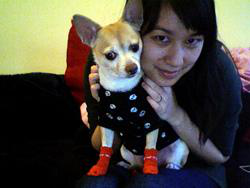

In [36]:
ToPILImage()(tim)

In [20]:
f = open('dogs', "rb")

In [21]:
import pickle

X = pickle.load(f, encoding="latin-1")

In [22]:
data, labels = X

In [23]:
data.shape

(20580, 128, 128, 3)

In [27]:
labels.shape

(20580, 120)

In [28]:
type(data)

numpy.ndarray

In [57]:
x_train, x_valid, y_train, y_valid = train_test_split(data, labels, test_size=0.20, random_state=123)

In [61]:
x_train[0].shape

(128, 128, 3)

In [63]:
x_train, y_train, x_valid, y_valid = map(
    torch.tensor, (x_train, y_train, x_valid, y_valid)
)

In [156]:
x_train.shape

torch.Size([16464, 128, 128, 3])

In [163]:
a = x_train[0].view(16384, 3)
a = torch.transpose(a, 0, 1)
a = a.view(3, 128, 128)
a.shape

torch.Size([3, 128, 128])

In [ ]:
n, c = x_train.shape
x_train, x_train.shape, y_train.min(), y_train.max()
print(x_train, y_train)
print(x_train.shape)
print(y_train.min(), y_train.max())

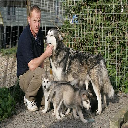

In [164]:
ToPILImage()(a)

In [202]:
x = torch.randn(2, 4, 3)
x

tensor([[[-0.3886,  1.3131,  0.0269],
         [ 0.0718,  1.4002, -0.4171],
         [ 0.4941,  0.3740, -1.4999],
         [-1.0730,  0.6493,  0.0508]],

        [[-0.3264, -0.9943,  1.5658],
         [ 1.7199, -0.8775,  0.5089],
         [ 1.2252, -0.7383,  1.0815],
         [ 0.5273,  0.4641, -0.6556]]])

In [219]:
#x = x.view(3, 4, 2)
xx = torch.transpose(x, 1, 2)
xx
#x.shape

tensor([[[-0.3886,  0.0718,  0.4941, -1.0730],
         [ 1.3131,  1.4002,  0.3740,  0.6493],
         [ 0.0269, -0.4171, -1.4999,  0.0508]],

        [[-0.3264,  1.7199,  1.2252,  0.5273],
         [-0.9943, -0.8775, -0.7383,  0.4641],
         [ 1.5658,  0.5089,  1.0815, -0.6556]]])

In [220]:
xx.shape

torch.Size([2, 3, 4])

In [192]:
a = data[11]
a = ToTensor()(a)

In [193]:
a

tensor([[[0.3216, 0.2941, 0.2392,  ..., 0.3451, 0.3725, 0.3686],
         [0.2941, 0.2902, 0.2392,  ..., 0.3569, 0.3843, 0.3725],
         [0.2980, 0.2902, 0.2157,  ..., 0.3137, 0.3333, 0.3333],
         ...,
         [0.3686, 0.3725, 0.3804,  ..., 0.2235, 0.2706, 0.3137],
         [0.4157, 0.3647, 0.3529,  ..., 0.2196, 0.2392, 0.2431],
         [0.2824, 0.3725, 0.3725,  ..., 0.1961, 0.2078, 0.2471]],

        [[0.5098, 0.5137, 0.4706,  ..., 0.5216, 0.5490, 0.5451],
         [0.4824, 0.5098, 0.4706,  ..., 0.5333, 0.5608, 0.5490],
         [0.4863, 0.5098, 0.4471,  ..., 0.4902, 0.5098, 0.5098],
         ...,
         [0.4431, 0.4392, 0.4353,  ..., 0.3725, 0.4196, 0.4627],
         [0.5020, 0.4392, 0.4196,  ..., 0.3686, 0.3882, 0.3922],
         [0.3686, 0.4588, 0.4392,  ..., 0.3529, 0.3647, 0.4000]],

        [[0.2667, 0.2745, 0.2588,  ..., 0.3922, 0.4196, 0.4157],
         [0.2392, 0.2706, 0.2588,  ..., 0.4039, 0.4314, 0.4196],
         [0.2431, 0.2706, 0.2353,  ..., 0.3608, 0.3804, 0.

In [198]:
a = torch.transpose(x_train[0], -3, 2)
a = torch.transpose(a, -2, 2)

In [199]:
a

tensor([[[0.4314, 0.2980, 0.2745,  ..., 0.1098, 0.6353, 0.1137],
         [0.2314, 0.2549, 0.2627,  ..., 0.3216, 0.5569, 0.2196],
         [0.3333, 0.2549, 0.1922,  ..., 0.3255, 0.3961, 0.2902],
         ...,
         [0.4157, 0.3020, 0.3647,  ..., 0.5137, 0.5333, 0.5176],
         [0.1647, 0.4275, 0.2824,  ..., 0.4431, 0.4314, 0.4902],
         [0.2235, 0.3059, 0.4980,  ..., 0.4196, 0.4039, 0.3765]],

        [[0.4392, 0.3059, 0.2824,  ..., 0.1725, 0.6824, 0.1137],
         [0.2392, 0.2627, 0.2706,  ..., 0.3725, 0.5961, 0.2392],
         [0.3412, 0.2627, 0.2000,  ..., 0.3569, 0.4118, 0.3412],
         ...,
         [0.4118, 0.3020, 0.3490,  ..., 0.4510, 0.4745, 0.4314],
         [0.1608, 0.4275, 0.2667,  ..., 0.3725, 0.3647, 0.4000],
         [0.2196, 0.3059, 0.4824,  ..., 0.3529, 0.3451, 0.3059]],

        [[0.4275, 0.2941, 0.2706,  ..., 0.0000, 0.5961, 0.0118],
         [0.2275, 0.2510, 0.2588,  ..., 0.2000, 0.5020, 0.1490],
         [0.3294, 0.2510, 0.1882,  ..., 0.2039, 0.3216, 0.

In [200]:
a.shape

torch.Size([3, 128, 128])

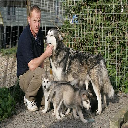

In [201]:
ToPILImage()(a)